### Libraries for visualization, for reading file, for using different tools

In [ ]:
%matplotlib inline
from ipywidgets import interactive
import matplotlib.pyplot as plt
import numpy as np

In [15]:
def read_data(path):                  # read binary file
    with open(path, "br") as bf:
        data = np.fromfile(bf, np.float64)
    return data

def transform_data_to_matrix(data):   # transform array of data to matrix
    return

# Original system

    n - count of moleculs
    a - count segment in the molecul
    L - size of dimensional
    
    T - temperature

### Dynamics original system 

    We simulate a system of N rigid rods of length `, moving in a 2D volume A with periodic boundary conditions. Steric rod-rod interactions are represented by a segment model, i.e., each rod is partitioned into n equidistant segments. All segments from diﬀerent rods interact with each other via a Yukawa potential [1]. The pair potential of two rods α and β, that have orientation unit vectors {ˆ uα, ˆ uβ} and are separated by the center-of-mass distance ∆rαβ, is given by
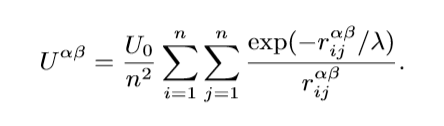

    Here, U0 is the potential amplitude, λ the screening length, and
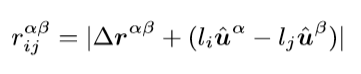
    
    the distance between the ith segment of rod α and the jth segment of rod β, with li ∈ [−(l−λ)/2,(l−λ)/2] denoting the position of segment i along the symmetry axis of the rod α. The screening length λ deﬁnes the eﬀective diameter of the segments. The ‘shape’ of a rod of length l is then determined by the aspect ratio [a = l/λ.]

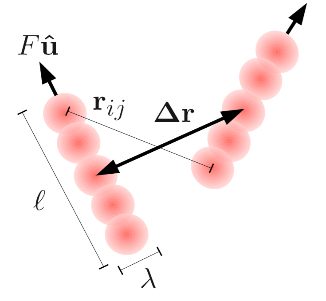

In [14]:
# For example
n = 100
L = 9.78082e-05
count = 5

T = 302

##  MATRIX OF POTENTIAL
    SIZE = 1000

###### Code

In [ ]:
path = "C:/Users/bohda/Documents/WorkinGermany/transform_system/potential_0.bin"

matrix_potential_0 = transform_data_to_matrix(path, 1000)    # 1000 - size

#name_cmap = "Greens"
ax = sns.heatmap(matrix_potential_0, linewidth=0.5, cmap=name_cmap)
plt.gcf().set_size_inches(10,8)
plt.show()

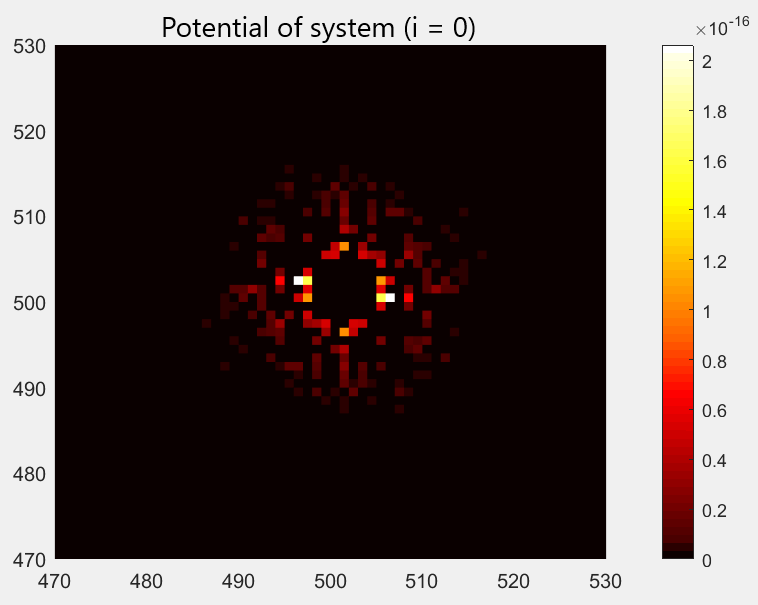

### Dynamic
    Since we are interested in the collision-dominated dynamics in dense bacterial suspensions, we neglect thermal and intrinsic [2] ﬂuctuations of the bacterial orientation and restrict our study to deterministic motions. With these simplifying assumptions, the equations of motion for the center-of-mass rα(t) and orientation ˆ uα(t) of an SPR are of ﬁrst order in time and can be written in the compact form
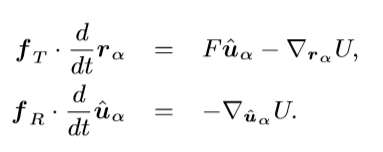

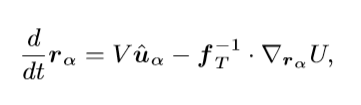
###### Code

In [ ]:
path_grad_x = "C:/Users/bohda/Documents/WorkinGermany/transform_system/grad_x.bin"
path_grad_y = "C:/Users/bohda/Documents/WorkinGermany/transform_system/grad_y.bin"

matrix_grad_x = transform_data_to_matrix(path_grad_x, 1000)    # 1000 - size
matrix_grad_y = transform_data_to_matrix(path_grad_y, 1000)    # 1000 - size

#name_cmap = "Greens"
ax = sns.heatmap(matrix_grad_y, linewidth=0.5, cmap=name_cmap)
plt.gcf().set_size_inches(10,8)
plt.show()

#name_cmap = "Greens"
ax = sns.heatmap(matrix_grad_x, linewidth=0.5, cmap=name_cmap)
plt.gcf().set_size_inches(10,8)
plt.show()


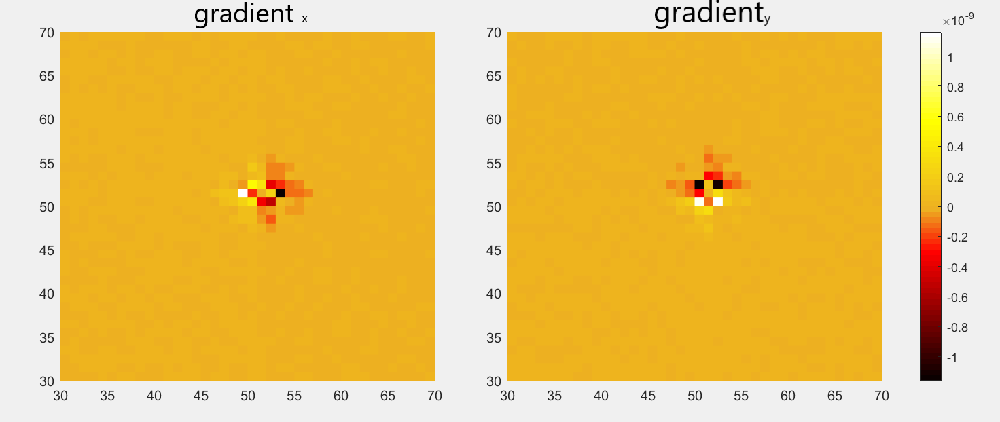

## Original System movement 

In [16]:
import io
import base64
from IPython.display import HTML

video = io.open("C:/Users/bohda/Documents/WorkinGermany/transform_system/movenemt_of_original_system.avi", 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''
<video controls>
    <source src="C:/Users/bohda/Documents/WorkinGermany/transform_system/movenemt_of_original_system.avi;base64,{0}" type="video/avi" />
</video>'''.format(encoded.decode('ascii')))

# Algoritm: Iterative Boltzmann Inversion
### Coarse-grained Potential Derivation With Multi-State



    Several approaches have been developed to derive and optimize CG forcefields. Among these, the iterative Boltzmann inversion (IBI) method has become a popular choice due to its straightforward nature, general applicability to a wide range of systems, and basis in structural properties. The IBI method relies on self-consistently adjusting a given potential to achieve convergence with target structural data; for nonbonded interactions this target data takes the form of the radial distribution function (RDF) between interaction sites and the potential is iteratively updated according to 
     
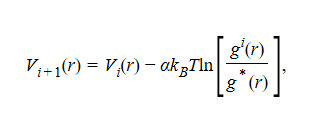
    
    
    where Vi(r) is a numerical pair potential; i represents the current iteration; α is a damping factor to suppress large changes to the potential update typically varying from 0.2 to unity, where smaller values tend to be necessary to capture dense and/or crystalline states);
     kB is the Boltzmann constant; T is the absolute temperature; r is the separation between particles; gi(r) is the pair RDF from the simulation of Vi(r), and g*(r) is the RDF of the target system mapped to the CG level. Although the CG potentials derived from IBI are typically able to accurately reproduce the target RDFs, they are, in general, only applicable at the state point for which they were derived, due to the structural nature of their derivation (e.g., note the explicit temperature dependence, as well as the implicit temperature and density dependence through the g(r) terms)
    

# g* (r) of original system

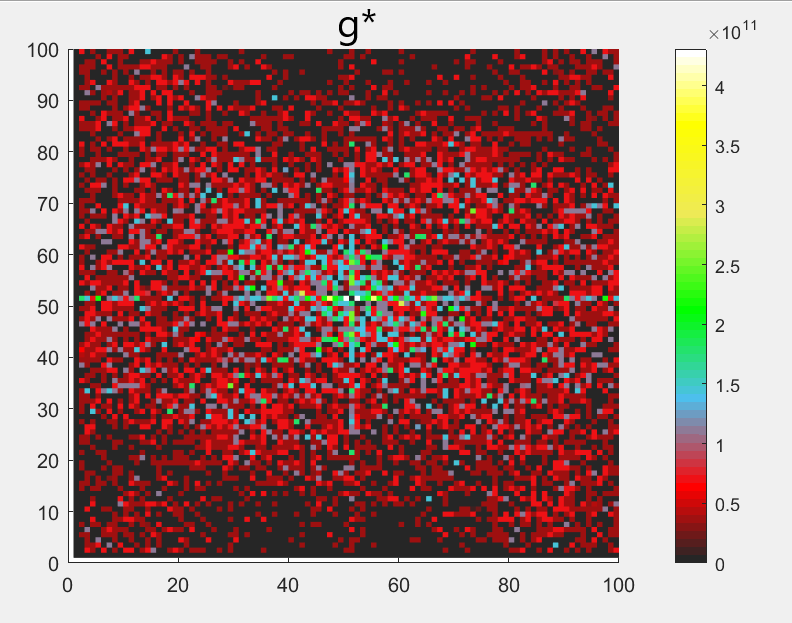

# RMSE 

    The root-mean-square deviation (RMSD) or root-mean-square error (RMSE) (or sometimes root-mean-squared error) is a frequently used measure of the differences between values (sample or population values) predicted by a model or an estimator and the values observed. The RMSD represents the square root of the second sample moment of the differences between predicted values and observed values or the quadratic mean of these differences. These deviations are called residuals when the calculations are performed over the data sample that was used for estimation and are called errors (or prediction errors) when computed out-of-sample. The RMSD serves to aggregate the magnitudes of the errors in predictions for various times into a single measure of predictive power. RMSD is a measure of accuracy, to compare forecasting errors of different models for a particular dataset and not between datasets, as it is scale-dependent.
   
   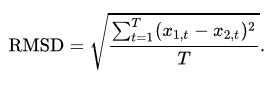
   
    RMSD is always non-negative, and a value of 0 (almost never achieved in practice) would indicate a perfect fit to the data. In general, a lower RMSD is better than a higher one. However, comparisons across different types of data would be invalid because the measure is dependent on the scale of the numbers used. 
    

    RMSD is the square root of the average of squared errors. The effect of each error on RMSD is proportional to the size of the squared error; thus larger errors have a disproportionately large effect on RMSD. Consequently, RMSD is sensitive to outliers.

In [3]:
import cufflinks as cf
import plotly
import plotly.offline as py
import plotly.graph_objs as go

cf.go_offline() # required to use plotly offline (no account required).
py.init_notebook_mode() # graphs charts inline (IPython).

iterations = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]

# RMSE = [8.4160278398500415e-32, 8.416027839849655e-32, 8.4160278398506195e-32, 8.4160278398502068e-32, 8.416027839849655e-32, 8.4160278398507531e-32, 8.4160278398499856e-32, 8.4160278398464287e-32, 8.4160278398495609e-32, 8.4160278398499856e-32, 8.4160278398482012e-32, 8.4160278398501947e-32, 8.4160278398487102e-32, 8.4160278398512457e-32, 8.4160278398496506e-32]
RMSE = [7.8932144457570713e-30, 7.8932144457543542e-30, 7.8932144457573488e-30, 7.8932144457514129e-30, 7.8932144457493096e-30, 7.8932144457513807e-30, 7.8932144457514676e-30, 7.8932144457487953e-30, 7.8932144457528997e-30, 7.8932144457410559e-30, 7.8932144457528142e-30, 7.8932144457474837e-30, 7.8932144457524204e-30, 7.8932144457442999e-30, 7.8932144457561563e-30]
# Create trace
trace = go.Scatter(
    #x = iterations,
    #y = RMSEs,
    x = iterations,
    y = RMSE,
    mode = 'lines+markers',
    name = 'lines+markers',
    line = dict(
        dash = 'dash'),
)

# Edit the layout
layout = dict(title = 'Dependence of RMSE with the number of iterations',
              xaxis = dict(title = 'RMSE'),
              yaxis = dict(title = 'Number iteration'),
              )
data = [trace]
fig = dict(data=data, layout=layout)

py.iplot(fig, filename='line-mode')

## Result

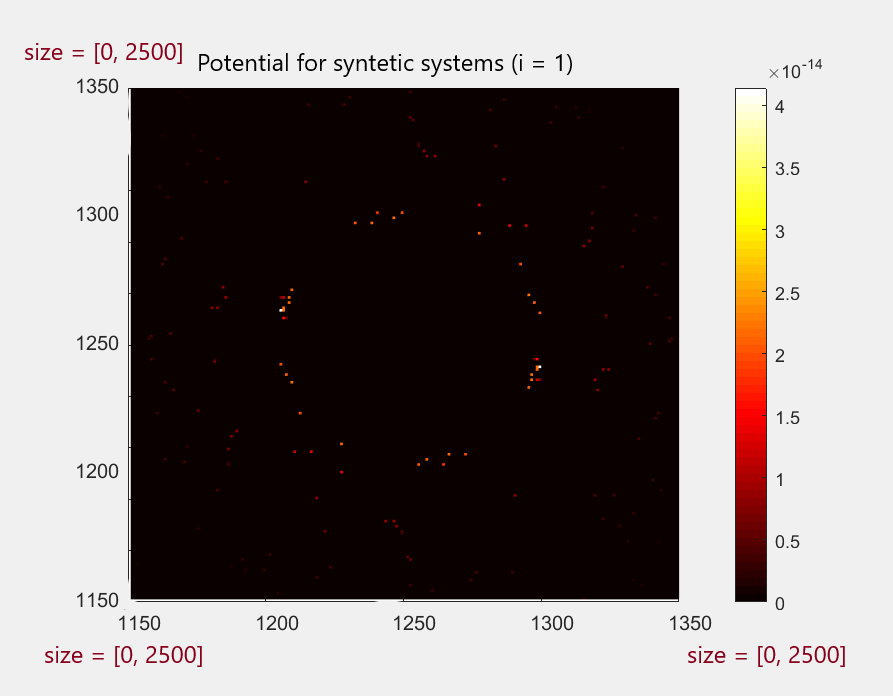